In [1]:
import pandas as pd

#load dataset
file_path = r'C:/Users/atibh/Downloads/Baltimore911.csv'

# Assuming the problematic column is column 7, specify its data type
df = pd.read_csv(file_path, dtype={'column_7': str}, low_memory=False)

df.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Location 1,Premise,vri_name1,Total Incidents
0,02/08/2020,2:18:00,5D,1700 CLIFTVIEW AVE,BURGLARY,I,NaN,312,EASTERN,DARLEY PARK,-76.593870,39.315341,NaN,GROCERY/CONFECTION,Eastern 1,1
1,02/08/2020,6:00:00,6G,700 N STREEPER ST,LARCENY,I,NaN,333,EASTERN,MADISON EASTEND,-76.577425,39.299094,NaN,ROW/TOWNHOUSE-OCC,NaN,1
2,02/08/2020,9:50:00,3JF,1400 N BROADWAY,ROBBERY - RESIDENCE,I,FIREARM,314,EASTERN,OLIVER,-76.594992,39.306941,NaN,ROW/TOWNHOUSE-OCC,NaN,1
3,02/08/2020,9:50:00,3JF,1400 N BROADWAY,ROBBERY - RESIDENCE,I,FIREARM,314,EASTERN,OLIVER,-76.594992,39.306941,NaN,ROW/TOWNHOUSE-OCC,NaN,1
4,02/08/2020,17:30:00,5A,1600 E OLIVER ST,BURGLARY,I,NaN,314,EASTERN,OLIVER,-76.595946,39.307350,NaN,ROW/TOWNHOUSE-OCC,Eastern 1,1


Initial Data:
    CrimeDate CrimeTime CrimeCode            Location          Description  \
0  02/08/2020   2:18:00        5D  1700 CLIFTVIEW AVE             BURGLARY   
1  02/08/2020   6:00:00        6G   700 N STREEPER ST              LARCENY   
2  02/08/2020   9:50:00       3JF     1400 N BROADWAY  ROBBERY - RESIDENCE   
3  02/08/2020   9:50:00       3JF     1400 N BROADWAY  ROBBERY - RESIDENCE   
4  02/08/2020  17:30:00        5A    1600 E OLIVER ST             BURGLARY   

  Inside/Outside   Weapon Post District     Neighborhood  Longitude  \
0              I      NaN  312  EASTERN      DARLEY PARK -76.593870   
1              I      NaN  333  EASTERN  MADISON EASTEND -76.577425   
2              I  FIREARM  314  EASTERN           OLIVER -76.594992   
3              I  FIREARM  314  EASTERN           OLIVER -76.594992   
4              I      NaN  314  EASTERN           OLIVER -76.595946   

    Latitude  Location 1             Premise  vri_name1  Total Incidents  
0  39.315341   

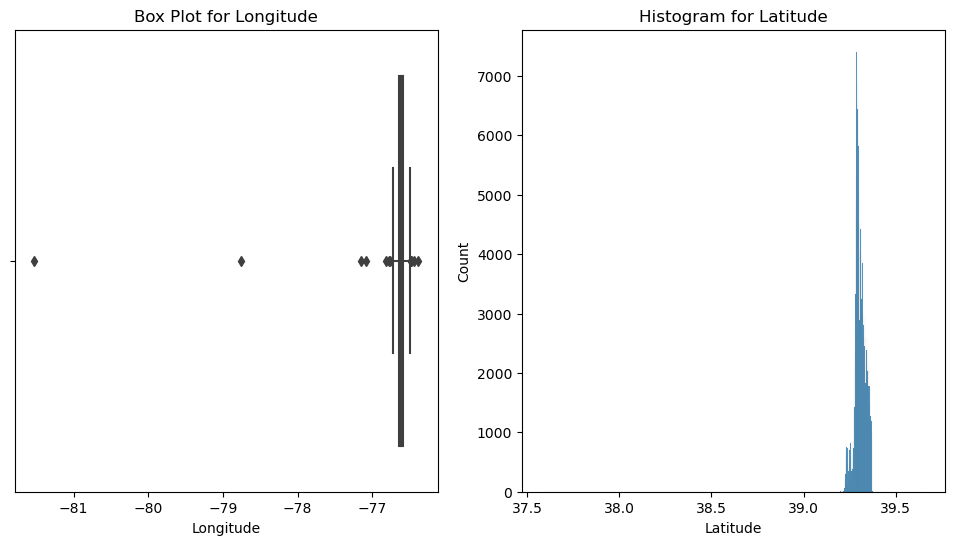


Cleaned Data:
    CrimeDate CrimeTime CrimeCode            Location          Description  \
0  02/08/2020   2:18:00        5D  1700 CLIFTVIEW AVE             BURGLARY   
1  02/08/2020   6:00:00        6G   700 N STREEPER ST              LARCENY   
2  02/08/2020   9:50:00       3JF     1400 N BROADWAY  ROBBERY - RESIDENCE   
3  02/08/2020   9:50:00       3JF     1400 N BROADWAY  ROBBERY - RESIDENCE   
4  02/08/2020  17:30:00        5A    1600 E OLIVER ST             BURGLARY   

  Inside/Outside   Weapon Post District     Neighborhood  Longitude  \
0              I      NaN  312  EASTERN      DARLEY PARK -76.593870   
1              I      NaN  333  EASTERN  MADISON EASTEND -76.577425   
2              I  FIREARM  314  EASTERN           OLIVER -76.594992   
3              I  FIREARM  314  EASTERN           OLIVER -76.594992   
4              I      NaN  314  EASTERN           OLIVER -76.595946   

    Latitude  Location 1             Premise  vri_name1  Total Incidents  
0  39.315341  

In [4]:
#Data Cleaning

import seaborn as sns
import matplotlib.pyplot as plt

# Initial data exploration
print("Initial Data:")
print(df.head())

# Data Visualization
plt.figure(figsize=(12, 6))

# Box plot for Longitude
plt.subplot(1, 2, 1)
sns.boxplot(x=df['Longitude'])
plt.title('Box Plot for Longitude')

# Histogram for Latitude
plt.subplot(1, 2, 2)
sns.histplot(x=df['Latitude'])
plt.title('Histogram for Latitude')

plt.show()

# Handling Outliers
outliers = (
    (df['Longitude'] < -180) | (df['Longitude'] > 180) |
    (df['Latitude'] < -90) | (df['Latitude'] > 90)
)

# Replace outliers with NaN
df.loc[outliers, ['Longitude', 'Latitude']] = None

# Handling Missing Values
df.dropna(subset=['Longitude', 'Latitude'], inplace=True)

# Save Cleaned Data to the same file
df.to_csv(file_path, index=False)

# Display cleaned data
print("\nCleaned Data:")
print(df.head())

In [19]:
#data_profiling 
df.describe()

,Longitude,Latitude,Location 1,Total Incidents
count,291126.000000,291126.000000,0.0,291126.0
mean,-76.617452,39.306746,NaN,1.0
std,0.043734,0.029658,NaN,0.0
min,-81.529189,37.577262,NaN,1.0
25%,-76.649094,39.288186,NaN,1.0
50%,-76.613977,39.302672,NaN,1.0
75%,-76.587080,39.326965,NaN,1.0
max,-76.383228,39.661332,NaN,1.0


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 291126 entries, 0 to 292760
Data columns (total 16 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   CrimeDate        291126 non-null  object 
 1   CrimeTime        291100 non-null  object 
 2   CrimeCode        291126 non-null  object 
 3   Location         290376 non-null  object 
 4   Description      291126 non-null  object 
 5   Inside/Outside   257792 non-null  object 
 6   Weapon           61220 non-null   object 
 7   Post             290379 non-null  object 
 8   District         291126 non-null  object 
 9   Neighborhood     281159 non-null  object 
 10  Longitude        291126 non-null  float64
 11  Latitude         291126 non-null  float64
 12  Location 1       0 non-null       float64
 13  Premise          257540 non-null  object 
 14  vri_name1        34576 non-null   object 
 15  Total Incidents  291126 non-null  int64  
dtypes: float64(3), int64(1), object(12)
me

In [22]:
df.shape

(291126, 16)

In [26]:
len(df)

291126

In [24]:
len(df.columns)

16

In [32]:
# Display basic statistics for the numeric column
numeric_stats = df['Total Incidents'].describe()

# Calculate Mean, Median, standard deviation for Column Total Incidents
mean_value = df['Total Incidents'].mean()
median_value = df['Total Incidents'].median()
std_dev_value = df['Total Incidents'].std()

# Display the results
print("Basic Statistics:")
print(numeric_stats)

print("\nMean:", mean_value)
print("Median:", median_value)
print("Standard Deviation:", std_dev_value)

#Min and Max values
min_value = df['Total Incidents'].min()
max_value = df['Total Incidents'].max()

# Display the results
print("Minimum Value:", min_value)
print("Maximum Value:", max_value)

Basic Statistics:
count    291126.0
mean          1.0
std           0.0
min           1.0
25%           1.0
50%           1.0
75%           1.0
max           1.0
Name: Total Incidents, dtype: float64

Mean: 1.0
Median: 1.0
Standard Deviation: 0.0
Minimum Value: 1
Maximum Value: 1


In [33]:
# Display basic statistics for the numeric column
numeric_stats = df['Longitude'].describe()

# Calculate Mean, Median, standard deviation for Column Total Incidents
mean_value = df['Longitude'].mean()
median_value = df['Longitude'].median()
std_dev_value = df['Longitude'].std()

# Display the results
print("Basic Statistics:")
print(numeric_stats)

print("\nMean:", mean_value)
print("Median:", median_value)
print("Standard Deviation:", std_dev_value)

#Min and Max values
min_value = df['Longitude'].min()
max_value = df['Longitude'].max()

# Display the results
print("Minimum Value:", min_value)
print("Maximum Value:", max_value)

Basic Statistics:
count    291126.000000
mean        -76.617452
std           0.043734
min         -81.529189
25%         -76.649094
50%         -76.613977
75%         -76.587080
max         -76.383228
Name: Longitude, dtype: float64

Mean: -76.61745184626443
Median: -76.6139769
Standard Deviation: 0.04373447607928038
Minimum Value: -81.5291885
Maximum Value: -76.38322763


In [34]:
# Display basic statistics for the numeric column
numeric_stats = df['Latitude'].describe()

# Calculate Mean, Median, standard deviation for Column Total Incidents
mean_value = df['Latitude'].mean()
median_value = df['Latitude'].median()
std_dev_value = df['Latitude'].std()

# Display the results
print("Basic Statistics:")
print(numeric_stats)

print("\nMean:", mean_value)
print("Median:", median_value)
print("Standard Deviation:", std_dev_value)

#Min and Max values
min_value = df['Latitude'].min()
max_value = df['Latitude'].max()

# Display the results
print("Minimum Value:", min_value)
print("Maximum Value:", max_value)

Basic Statistics:
count    291126.000000
mean         39.306746
std           0.029658
min          37.577262
25%          39.288186
50%          39.302672
75%          39.326965
max          39.661332
Name: Latitude, dtype: float64

Mean: 39.30674569832813
Median: 39.30267161
Standard Deviation: 0.029657887347020687
Minimum Value: 37.57726184
Maximum Value: 39.66133158


In [35]:
# Display basic statistics for the numeric column
numeric_stats = df['Location 1'].describe()

# Calculate Mean, Median, standard deviation for Column Total Incidents
mean_value = df['Location 1'].mean()
median_value = df['Location 1'].median()
std_dev_value = df['Location 1'].std()

# Display the results
print("Basic Statistics:")
print(numeric_stats)

print("\nMean:", mean_value)
print("Median:", median_value)
print("Standard Deviation:", std_dev_value)

#Min and Max values
min_value = df['Location 1'].min()
max_value = df['Location 1'].max()

# Display the results
print("Minimum Value:", min_value)
print("Maximum Value:", max_value)

Basic Statistics:
count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: Location 1, dtype: float64

Mean: nan
Median: nan
Standard Deviation: nan
Minimum Value: nan
Maximum Value: nan


In [38]:
num_unique_values = df['Total Incidents'].nunique()

# Find the counts of each unique value
value_counts = df['Total Incidents'].value_counts().nlargest(3)

print("Total number of unique values:", num_unique_values)
print("\nCounts of each unique value:")
print(value_counts)

# Find the three attribute values with the largest count
largest_counts = value_counts.head(3)
print("\nThree attribute values with the largest count:")
print(largest_counts)

Total number of unique values: 1

Counts of each unique value:
1    291126
Name: Total Incidents, dtype: int64

Three attribute values with the largest count:
1    291126
Name: Total Incidents, dtype: int64


In [39]:
# Calculate the percentage of rows with missing values
missing_rows_percentage = df.isnull().any(axis=1).sum() / len(df) * 100

# Display the result
print("Percentage of Rows with Missing Values:", missing_rows_percentage)

Percentage of Rows with Missing Values: 100.0


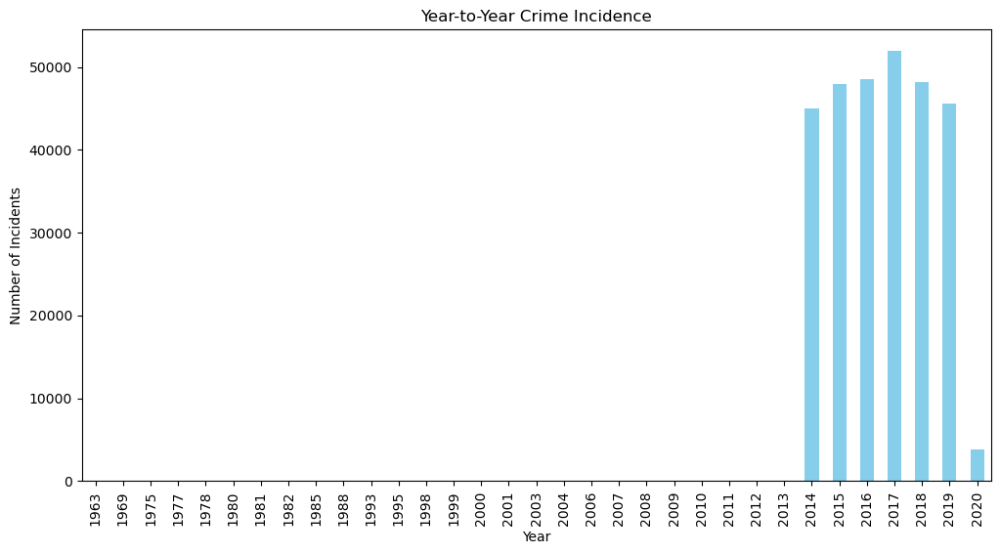

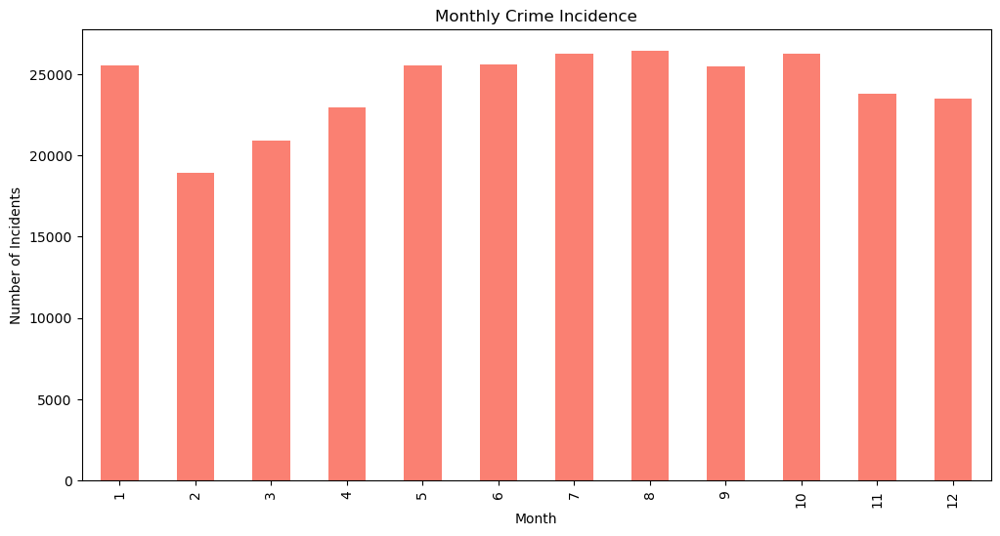

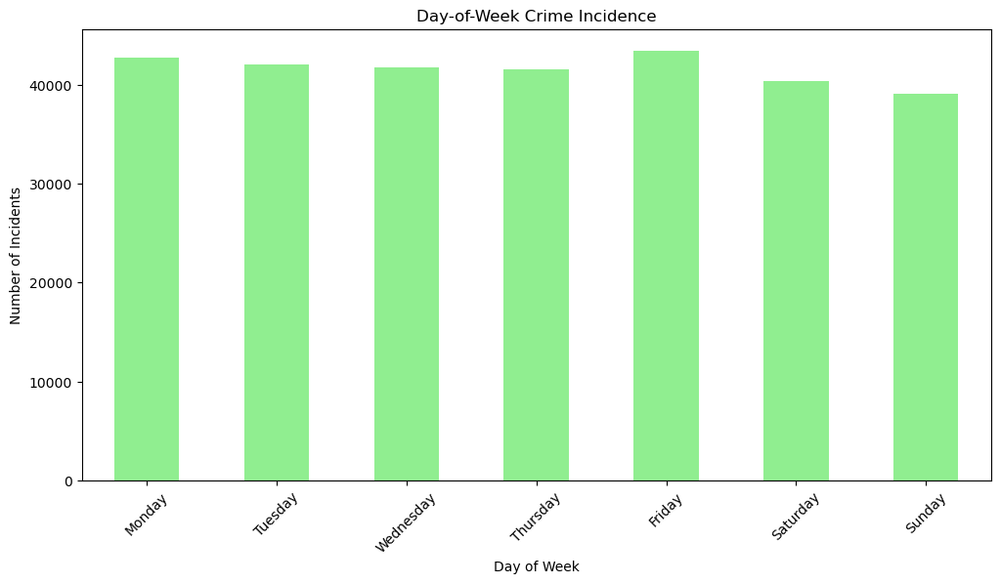

In [41]:
# Convert the 'Date' column to datetime
df['CrimeDate'] = pd.to_datetime(df['CrimeDate'])

# Extract year, month, and day-of-week from the 'Date' column
df['Year'] = df['CrimeDate'].dt.year
df['Month'] = df['CrimeDate'].dt.month
df['DayOfWeek'] = df['CrimeDate'].dt.dayofweek  # Monday is 0 and Sunday is 6

# Group by year, month, and day-of-week and count the number of incidents
yearly_counts = df.groupby('Year').size()
monthly_counts = df.groupby('Month').size()
day_of_week_counts = df.groupby('DayOfWeek').size()

# Plotting

# Year-to-Year
plt.figure(figsize=(12, 6))
yearly_counts.plot(kind='bar', color='skyblue')
plt.title('Year-to-Year Crime Incidence')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.show()

# Monthly
plt.figure(figsize=(12, 6))
monthly_counts.plot(kind='bar', color='salmon')
plt.title('Monthly Crime Incidence')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.show()

# Day-of-Week
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.figure(figsize=(12, 6))
day_of_week_counts.plot(kind='bar', color='lightgreen')
plt.title('Day-of-Week Crime Incidence')
plt.xlabel('Day of Week')
plt.xticks(ticks=range(7), labels=days_of_week, rotation=45)
plt.ylabel('Number of Incidents')
plt.show()

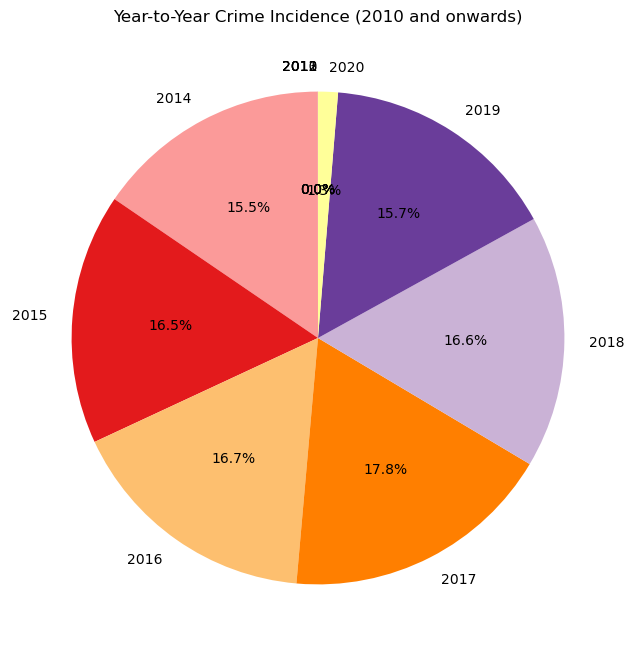

In [45]:
# Year-to-Year Pie Chart
plt.figure(figsize=(8, 8))
plt.pie(yearly_counts, labels=yearly_counts.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
plt.title('Year-to-Year Crime Incidence (2010 and onwards)')
plt.show()

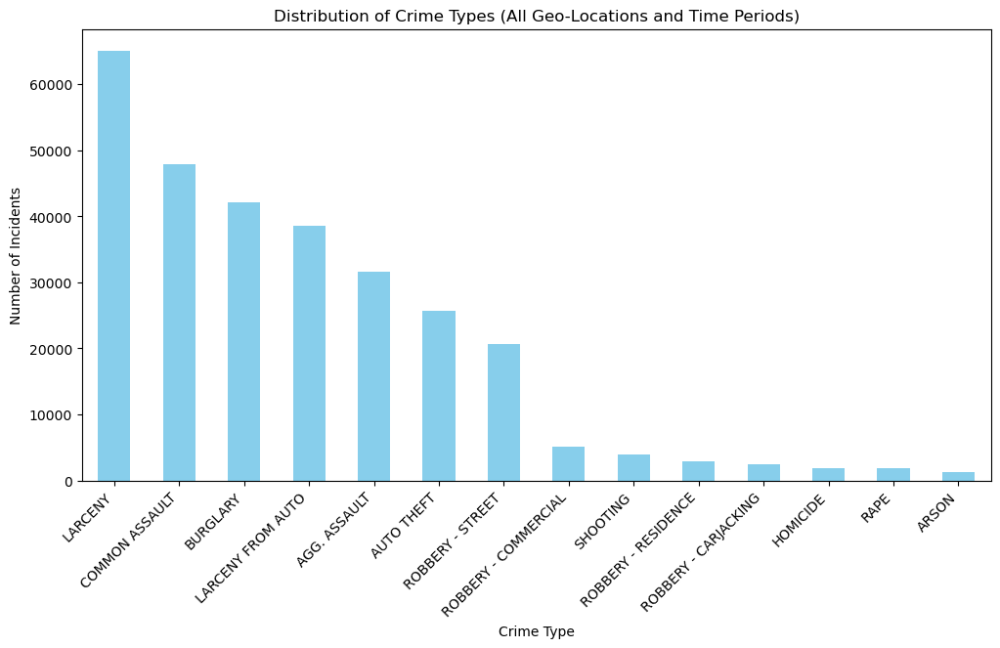

In [46]:
# Extract crime types and count the number of incidents for each type
crime_type_counts = df['Description'].value_counts()

# Plotting
plt.figure(figsize=(12, 6))
crime_type_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Crime Types (All Geo-Locations and Time Periods)')
plt.xlabel('Crime Type')
plt.ylabel('Number of Incidents')
plt.xticks(rotation=45, ha='right')
plt.show()

<Figure size 1600x800 with 0 Axes>

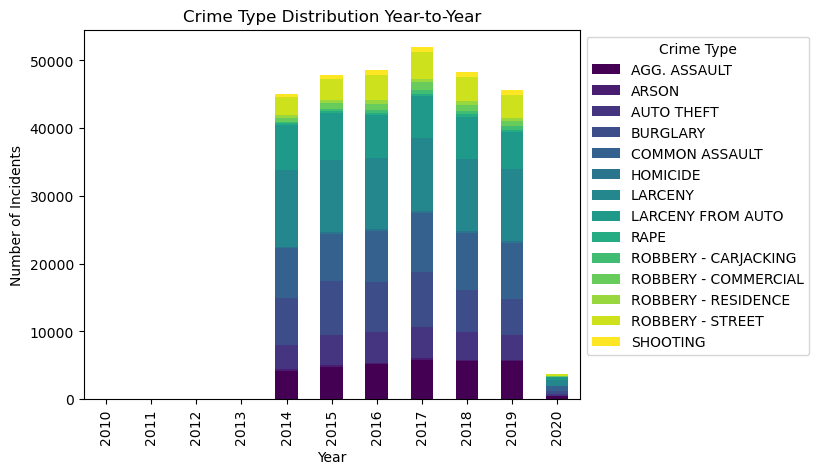

<Figure size 1600x800 with 0 Axes>

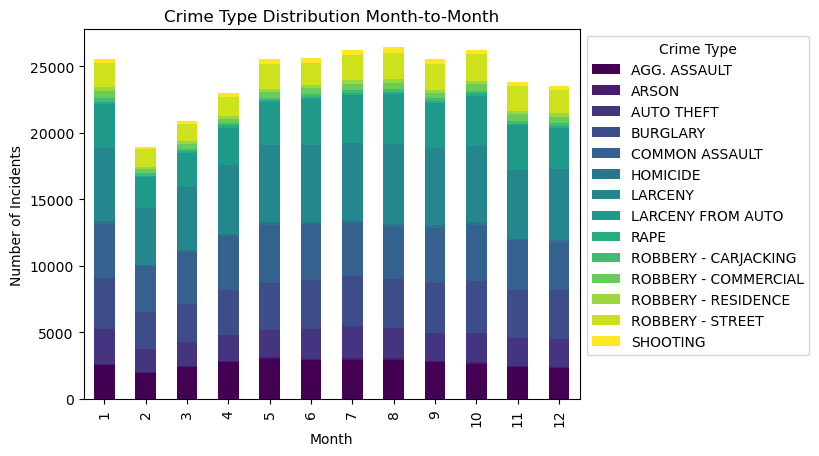

<Figure size 1600x800 with 0 Axes>

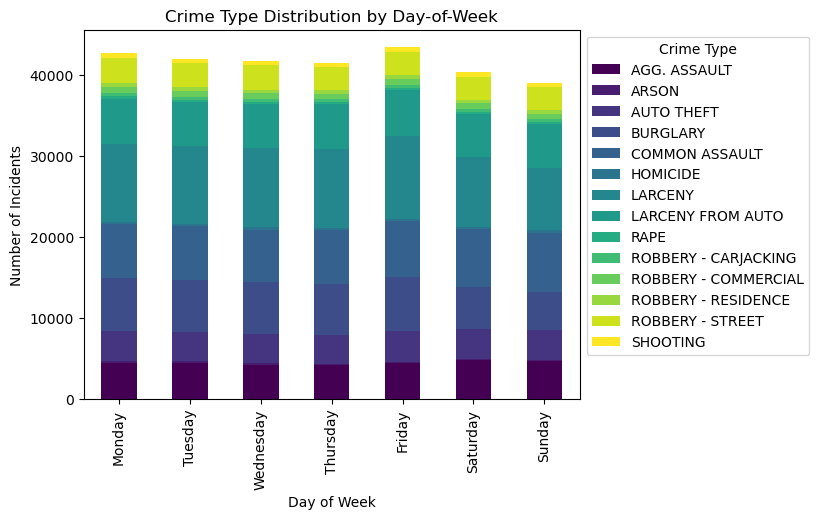

In [74]:
# Convert the 'Date' column to datetime
df['CrimeDate'] = pd.to_datetime(df['CrimeDate'])

# Extract year, month, and day-of-week from the 'Date' column
df['Year'] = df['CrimeDate'].dt.year
df['Month'] = df['CrimeDate'].dt.month
df['DayOfWeek'] = df['CrimeDate'].dt.dayofweek  # Monday is 0 and Sunday is 6

# Group by year, month, and day-of-week, and count the number of incidents for each crime type
yearly_crime_type_counts = df.groupby(['Year', 'Description']).size()
monthly_crime_type_counts = df.groupby(['Month', 'Description']).size()
day_of_week_crime_type_counts = df.groupby(['DayOfWeek', 'Description']).size()


# Year-to-Year
plt.figure(figsize=(16, 8))
yearly_crime_type_counts.unstack().plot(kind='bar', stacked=True, colormap='viridis')
plt.title('Crime Type Distribution Year-to-Year')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.legend(title='Crime Type', bbox_to_anchor=(1, 1))
plt.show()


# Month-to-Month
plt.figure(figsize=(16, 8))
monthly_crime_type_counts.unstack().plot(kind='bar', stacked=True, colormap='viridis')
plt.title('Crime Type Distribution Month-to-Month')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.legend(title='Crime Type', bbox_to_anchor=(1, 1))
plt.show()

# Day-of-Week
plt.figure(figsize=(16, 8))
day_of_week_crime_type_counts.unstack().plot(kind='bar', stacked=True, colormap='viridis')
plt.title('Crime Type Distribution by Day-of-Week')
plt.xlabel('Day of Week')
plt.ylabel('Number of Incidents')
plt.xticks(ticks=range(7), labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.legend(title='Crime Type', bbox_to_anchor=(1, 1))
plt.show()

In [51]:
pip install dash pandas plotly


  Obtaining dependency information for dash from https://files.pythonhosted.org/packages/9b/b4/d522c16b41a8da013fd60a67f9618e57c504cd2c80e02a7a861413b93906/dash-2.13.0-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/10.4 MB ? eta -:--:--
   ---------------------------------------- 0.1/10.4 MB 3.3 MB/s eta 0:00:04
   -- ------------------------------------- 0.6/10.4 MB 7.2 MB/s eta 0:00:02
   -------- ------------------------------- 2.2/10.4 MB 17.6 MB/s eta 0:00:01
   ------------------- -------------------- 5.1/10.4 MB 27.3 MB/s eta 0:00:01
   --------------------------- ------------ 7.2/10.4 MB 30.9 MB/s eta 0:00:01
   ------------------------------------- -- 9.7/10.4 MB 34.6 MB/s eta 0:00:01
   ---------------------------------------  10.4/10.4 MB 43.5 MB/s eta 0:00:01
   ---------------------------------------- 10.4/10.4 MB 36.3 MB/s eta 0:00:00


In [61]:
import plotly.express as px
import dash
from dash import dcc, html
from dash.dependencies import Input, Output


# Create the Dash web application
app = dash.Dash(__name__)

# Define the layout of the dashboard
app.layout = html.Div([
    html.H1("Crime Exploration Dashboard"),

    # Dropdown for selecting location
    dcc.Dropdown(
        id='location-dropdown',
        options=[{'label': location, 'value': location} for location in df['Location'].unique()],
        value=df['Location'].unique()[0],
        multi=False,
        style={'width': '50%'}
    ),

    # Line chart for temporal patterns
    dcc.Graph(id='temporal-pattern-chart'),

    # Bar chart for crime type distribution
    dcc.Graph(id='crime-type-distribution-chart')
])

# Define callback to update charts based on user input
@app.callback(
    [Output('temporal-pattern-chart', 'figure'),
     Output('crime-type-distribution-chart', 'figure')],
    [Input('location-dropdown', 'value')]
)
def update_charts(selected_location):
    # Filter data based on selected location
    filtered_df = df[df['Location'] == selected_location]

    # Temporal pattern chart (Year-to-Year)
    yearly_counts = filtered_df.groupby('Year').size().reset_index(name='Incidents')
    temporal_pattern_chart = px.line(yearly_counts, x='Year', y='Incidents', title='Year-to-Year Temporal Pattern')

    # Crime type distribution chart
    crime_type_counts = filtered_df['Description'].value_counts().reset_index(name='Incidents')
    crime_type_distribution_chart = px.bar(crime_type_counts, x='index', y='Incidents', title='Crime Type Distribution')

    return temporal_pattern_chart, crime_type_distribution_chart

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)

In [62]:
# Assuming your dataset has 'Latitude' and 'Longitude' columns
fig = px.scatter_mapbox(df, 
                        lat='Latitude', 
                        lon='Longitude', 
                        color='Description',  # Corrected column name
                        size_max=15,
                        zoom=10,
                        title='Crime Type Distribution Across Locations',
                        mapbox_style="carto-positron")

# Show the map
fig.show()